In [1]:
# # This Python 3 environment comes with many helpful analytics libraries installed
# # It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# # For example, here's several helpful packages to load

# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# # Input data files are available in the read-only "../input/" directory
# # For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk(r'D:\Real Estate\House_Style_Project\House_style_ML\dataset'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# # You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# # You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
import numpy as np  # Linear algebra
import pandas as pd  # Data processing, CSV file I/O (e.g. pd.read_csv)
import os

# Use a relative path to the dataset directory
dataset_dir = os.path.join(os.getcwd(), 'dataset')

# Walk through the dataset directory
for dirname, _, filenames in os.walk(dataset_dir):
    for filename in filenames:
        print(os.path.join(dirname, filename))


d:\Real Estate\House_Style_Project\House_style_ML\dataset\ML-AR-Chicago School\078f8f88971426ae729d919ce11e6942.jpg
d:\Real Estate\House_Style_Project\House_style_ML\dataset\ML-AR-Chicago School\0df505fa53491a9ac49ba2f00de22f2d.jpg
d:\Real Estate\House_Style_Project\House_style_ML\dataset\ML-AR-Chicago School\1d66809eff05a23dab38d79ec34777fc.jpg
d:\Real Estate\House_Style_Project\House_style_ML\dataset\ML-AR-Chicago School\20c478f272d5d14015eab8170563a454.jpg
d:\Real Estate\House_Style_Project\House_style_ML\dataset\ML-AR-Chicago School\3b6b2134568dd116206bf7ff59e7c1bd.jpg
d:\Real Estate\House_Style_Project\House_style_ML\dataset\ML-AR-Chicago School\4013de6cc22838cd0ab14fd242ecbd84.jpg
d:\Real Estate\House_Style_Project\House_style_ML\dataset\ML-AR-Chicago School\53b07aa2b907885a963ba95ee2ae1aa7.jpg
d:\Real Estate\House_Style_Project\House_style_ML\dataset\ML-AR-Chicago School\57a48b2cf75cac21cd042d06257d326f.jpg
d:\Real Estate\House_Style_Project\House_style_ML\dataset\ML-AR-Chicago 

In [3]:
# !pip install python_splitter

In [4]:
import python_splitter
# If you want to create only Train-Test Folder(not Validation Folder)
# python_splitter.split_from_folder("D:\Real Estate\House_Style_Project\House_style_ML\dataset", train = 0.7, test = 0.3)
python_splitter.split_from_folder(os.path.join(os.getcwd(), 'dataset'), train=0.7, test=0.3)

✅Checking SOURCE directory...
0.7 0 0.3
✅Checking percentage validation...
✅Making required directories...
✅Shuffling data...
✅Getting ready for copying files...

-------------Successfully splitted !!!--------------- 


In [5]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
from tensorflow.keras.applications import MobileNet
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Flatten, Dropout
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

## Splitted Data

In [6]:
target_img_shape = (224,224)
# train_dir = r'D:\Real Estate\House_Style_Project\House_style_ML\Train_Test_Folder\train'
# val_dir = r'D:\Real Estate\House_Style_Project\House_style_ML\Train_Test_Folder\test'

train_dir = os.path.join(os.path.join(os.getcwd(), 'Train_Test_Folder'), 'train')
val_dir = os.path.join(os.path.join(os.getcwd(), 'Train_Test_Folder'), 'test')

In [7]:
train_datagen = ImageDataGenerator(preprocessing_function = preprocess_input)
train_set = train_datagen.flow_from_directory(train_dir, target_size = target_img_shape, batch_size = 32, class_mode = 'sparse')

# Augmenting training data with transformations
# train_datagen = ImageDataGenerator(
#     preprocessing_function=preprocess_input,
#     rotation_range=20,      # Randomly rotate images by 20 degrees
#     width_shift_range=0.2,  # Randomly shift images horizontally (15% of the width)
#     height_shift_range=0.2, # Randomly shift images vertically (15% of the height)
#     shear_range=0.9,       # Randomly apply shearing
#     zoom_range=0.5,        # Randomly zoom inside pictures
#     horizontal_flip=True,   # Randomly flip images horizontally
#     fill_mode='nearest'     # Fill pixels when the image is rotated or shifted
# )

# train_set = train_datagen.flow_from_directory(
#     train_dir, 
#     target_size=target_img_shape, 
#     batch_size=32, 
#     class_mode='sparse'
# )

val_datagen = ImageDataGenerator(preprocessing_function = preprocess_input)
val_set = val_datagen.flow_from_directory(val_dir, target_size = target_img_shape, batch_size = 32, class_mode = 'sparse')

Found 286 images belonging to 13 classes.
Found 129 images belonging to 13 classes.


{'ML-AR-COLONIAL': 0, 'ML-AR-Chicago School': 1, 'ML-AR-Classic': 2, 'ML-AR-MEDITERRANEAN': 3, 'ML-AR-MID CENTURY': 4, 'ML-AR-Modern': 5, 'ML-AR-Modern Minimal': 6, 'ML-AR-Oriental': 7, 'ML-AR-SCANDINAVIAN': 8, 'ML-AR-THAI': 9, 'ML-AR-TRANSITIONAL': 10, 'ML-AR-TUDOR HOUSE': 11, 'ML-AR-VICTORIAN': 12}
(32, 224, 224, 3)
(32,)
class 11.0


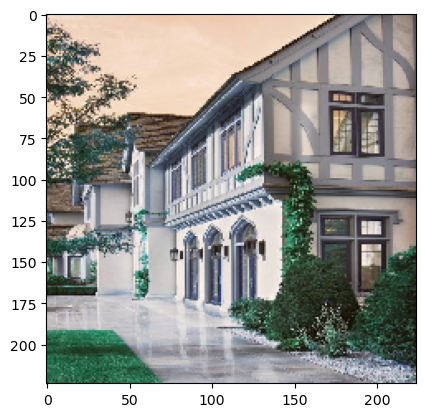

In [8]:
print(train_set.class_indices)
for image_batch, labels_batch in train_set:
    print(image_batch.shape)
    print(labels_batch.shape)

    img = image_batch[0] - image_batch[0].min()
    img /= 275.0
    plt.imshow(img)
    print('class', labels_batch[0])
    break

In [9]:
ids, counts = np.unique(train_set.classes, return_counts = True)
print(ids)
print(counts)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12]
[20 20 20 20 26 11 20 20 20 37 20 32 20]


In [10]:
labels = (train_set.class_indices)
labels = dict((v,k) for k,v in labels.items())
labels

for i in ids:
    print('{:>8} = {}'.format(labels[i], counts[i]))

ML-AR-COLONIAL = 20
ML-AR-Chicago School = 20
ML-AR-Classic = 20
ML-AR-MEDITERRANEAN = 20
ML-AR-MID CENTURY = 26
ML-AR-Modern = 11
ML-AR-Modern Minimal = 20
ML-AR-Oriental = 20
ML-AR-SCANDINAVIAN = 20
ML-AR-THAI = 37
ML-AR-TRANSITIONAL = 20
ML-AR-TUDOR HOUSE = 32
ML-AR-VICTORIAN = 20


In [11]:
ids, counts = np.unique(val_set.classes, return_counts = True)
print(ids)
print(counts)

[ 0  1  2  3  4  5  6  7  8  9 10 11 12]
[ 9  9  9  9 12  5  9  9  9 17  9 14  9]


In [12]:
_, train_count = np.unique(train_set.classes, return_counts = True)
_, val_count = np.unique(val_set.classes, return_counts = True)

print('Ratio Validation/Training set:', val_count/train_count * 100)

Ratio Validation/Training set: [45.         45.         45.         45.         46.15384615 45.45454545
 45.         45.         45.         45.94594595 45.         43.75
 45.        ]


In [13]:
in_shape = (target_img_shape[0], target_img_shape[1], 3)
in_shape

(224, 224, 3)

In [14]:
# from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Dense, Dropout, Flatten, GlobalAveragePooling2D
base_model = ResNet50(include_top=False,
                      weights='imagenet',
                      input_shape=in_shape)

model = Sequential()
model.add(base_model)
model.add(GlobalAveragePooling2D())  # Replacing Flatten with GAP to reduce overfitting
model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))  # Dropout to reduce overfitting
model.add(Dense(128, activation='relu'))
model.add(Dropout(0.5))  # Dropout to reduce overfitting
model.add(Dense(64, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(13, activation='softmax'))  # Output layer for 13 classes
base_model.trainable = False
# base_model.trainable = True
model.summary()


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ resnet50 (Functional)           │ (None, 7, 7, 2048)     │    23,587,712 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 2048)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 128)            │        32,896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 64)             │         8,256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 13)             │           845 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 24,154,253 (92.14 MB)

 Trainable params: 566,541 (2.16 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [15]:
# from tensorflow.keras.applications import ResNet50
# from tensorflow.keras.models import Model
# from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
# from tensorflow.keras.optimizers import Adam

# # Load the ResNet50 model pre-trained on ImageNet
# base_model = ResNet50(include_top=False, weights='imagenet', input_shape=in_shape)

# # Adding the classification head
# x = base_model.output
# x = GlobalAveragePooling2D()(x)  # Global average pooling layer
# output_layer = Dense(13, activation='softmax')(x)  # Output layer for 13 classes

# # Creating the final model
# model = Model(inputs=base_model.input, outputs=output_layer)

# # Optionally, you can freeze the base model layers during initial training
# base_model.trainable = False

# # Compile the model
# # model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])

# model.summary()

In [16]:
# base_model.trainable = False

In [17]:
print("Trainable..\n---")
for variable in model.trainable_variables:
    print(variable.name)

Trainable..
---
kernel
bias
kernel
bias
kernel
bias
kernel
bias


In [18]:
# resnet.summary()

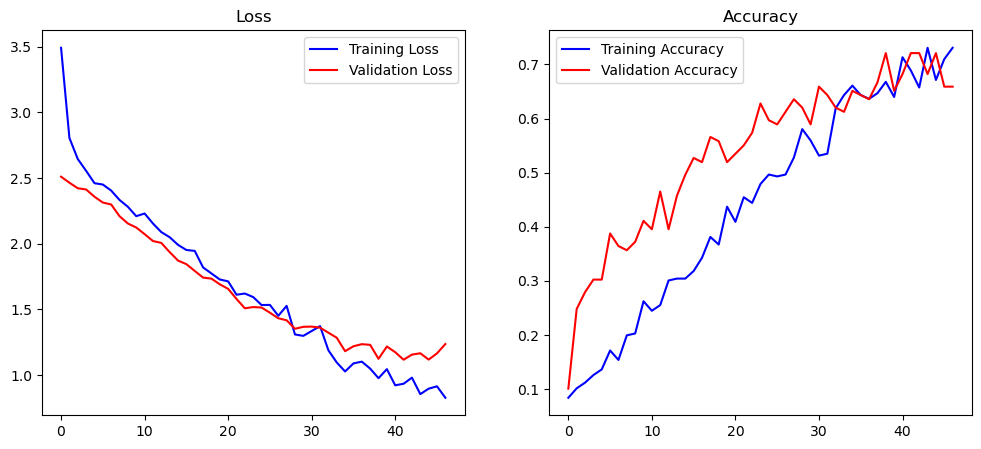

9/9 ━━━━━━━━━━━━━━━━━━━━ 17s 2s/step - accuracy: 0.7252 - loss: 0.7931 - val_accuracy: 0.6589 - val_loss: 1.2367
Epoch 47: early stopping
Restoring model weights from the end of the best epoch: 42.
Time Taken: 13.18 minutes


In [19]:
import time
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback
from IPython.display import clear_output, display

# Model Compilation
model.compile(optimizer=Adam(learning_rate=0.001), 
              loss='sparse_categorical_crossentropy', 
              metrics=['accuracy'])

# Callbacks
es = EarlyStopping(monitor='val_loss', verbose=1, patience=5, restore_best_weights=True)
mc = ModelCheckpoint('best_model13cls.keras', monitor='val_accuracy', verbose=1, save_best_only=True)

# Custom Callback for Real-Time Plotting with IPython.display
class RealTimePlot(Callback):
    def on_train_begin(self, logs=None):
        self.epochs = []
        self.losses = []
        self.val_losses = []
        self.accuracies = []
        self.val_accuracies = []

    def on_epoch_end(self, epoch, logs=None):
        self.epochs.append(epoch)
        self.losses.append(logs['loss'])
        self.val_losses.append(logs['val_loss'])
        self.accuracies.append(logs['accuracy'])
        self.val_accuracies.append(logs['val_accuracy'])

        # Clear the output and plot the updated data
        clear_output(wait=True)
        plt.figure(figsize=(12, 5))

        # Plotting the losses
        plt.subplot(1, 2, 1)
        plt.plot(self.epochs, self.losses, label='Training Loss', color='b')
        plt.plot(self.epochs, self.val_losses, label='Validation Loss', color='r')
        plt.title("Loss")
        plt.legend()

        # Plotting the accuracies
        plt.subplot(1, 2, 2)
        plt.plot(self.epochs, self.accuracies, label='Training Accuracy', color='b')
        plt.plot(self.epochs, self.val_accuracies, label='Validation Accuracy', color='r')
        plt.title("Accuracy")
        plt.legend()

        plt.show()

# Instantiate the custom callback
real_time_plot = RealTimePlot()

# Training the model with the custom callback
start = time.time()
history = model.fit(train_set,
                    validation_data=val_set,
                    epochs=100, 
                    verbose=1, 
                    callbacks=[es, mc, real_time_plot])
end = time.time()

print("Time Taken: {:.2f} minutes".format((end - start)/60))


In [20]:
acc = model.evaluate(val_set, steps=len(val_set), verbose=1)
print('score = {:.3f}'.format(acc[1]))

5/5 ━━━━━━━━━━━━━━━━━━━━ 5s 843ms/step - accuracy: 0.6956 - loss: 1.1593
score = 0.721


In [21]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
def predict(img_fname):
    # Load and preprocess the image
    img = load_img(img_fname, target_size=target_img_shape)  # Adjust target_img_shape as per your model's input
    plt.figure()  # Open a new figure for each image
    plt.imshow(img)
    plt.axis('off')  # Turn off axes for better viewing
    plt.title(os.path.basename(os.path.dirname(img_fname)))
    plt.show()

    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = preprocess_input(img)
    
    # Make prediction
    pred = model.predict(img)
    pred_probabilities = pred[0]

    # Get the top 3 predictions
    top_indices = pred_probabilities.argsort()[-3:][::-1]  # Indices of top 3 predictions
    top_labels = [(list(labels.values())[i], pred_probabilities[i]) for i in top_indices]  # Assuming `labels` is a dictionary or list

    # Display the top 3 predictions with their probabilities
    print("Top 3 Predictions:")
    for label, probability in top_labels:
        print(f"{label} : {round(probability * 100, 2):.2f}%")

    # Extracting the actual class from the file path
    actual_cls = os.path.basename(os.path.dirname(img_fname))  # Assumes the image file is within a folder named by its class
    print('Actual Class:', actual_cls)
    
    # Get the predicted class (highest probability)
    pred_cls = list(labels.values())[np.argmax(pred, -1)[0]]
    print('Prediction:', pred_cls)


In [22]:
labels

{0: 'ML-AR-COLONIAL',
 1: 'ML-AR-Chicago School',
 2: 'ML-AR-Classic',
 3: 'ML-AR-MEDITERRANEAN',
 4: 'ML-AR-MID CENTURY',
 5: 'ML-AR-Modern',
 6: 'ML-AR-Modern Minimal',
 7: 'ML-AR-Oriental',
 8: 'ML-AR-SCANDINAVIAN',
 9: 'ML-AR-THAI',
 10: 'ML-AR-TRANSITIONAL',
 11: 'ML-AR-TUDOR HOUSE',
 12: 'ML-AR-VICTORIAN'}

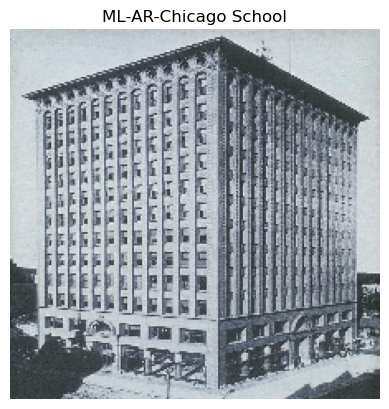

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-Modern Minimal : 0.00%
ML-AR-VICTORIAN : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


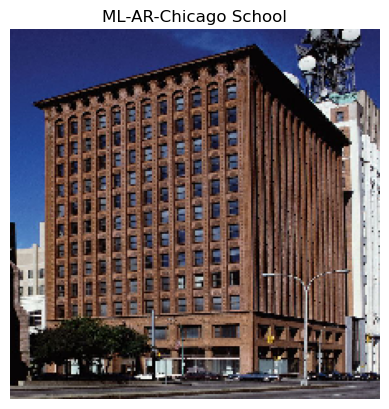

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Top 3 Predictions:
ML-AR-Chicago School : 99.81%
ML-AR-Modern Minimal : 0.12%
ML-AR-VICTORIAN : 0.04%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


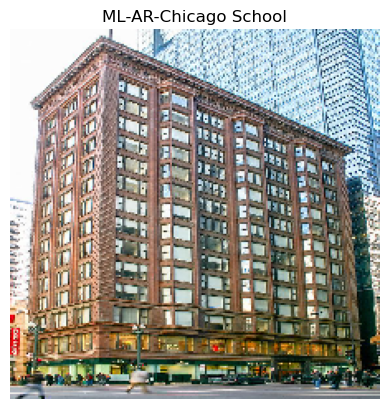

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-Modern Minimal : 0.00%
ML-AR-VICTORIAN : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


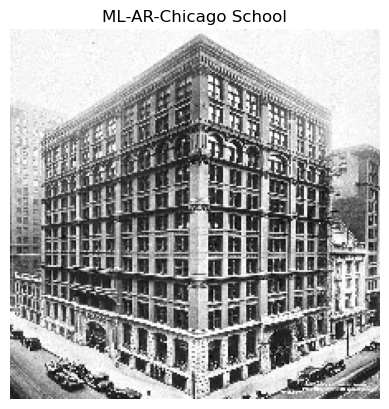

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
Top 3 Predictions:
ML-AR-Chicago School : 100.00%
ML-AR-Modern Minimal : 0.00%
ML-AR-VICTORIAN : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


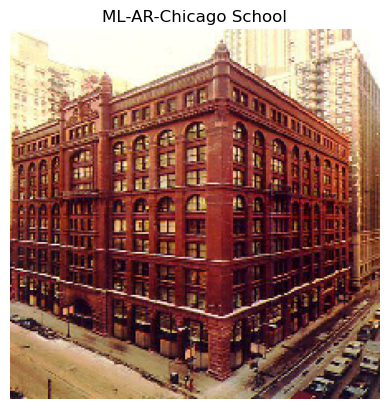

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
Top 3 Predictions:
ML-AR-Chicago School : 99.99%
ML-AR-Modern Minimal : 0.01%
ML-AR-VICTORIAN : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


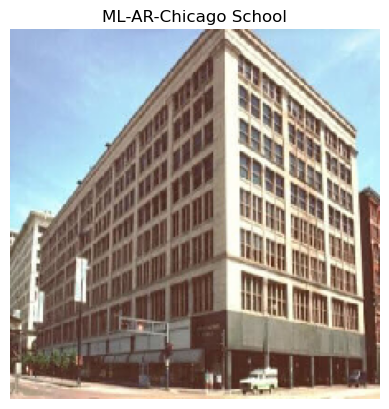

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Top 3 Predictions:
ML-AR-Chicago School : 99.78%
ML-AR-Modern Minimal : 0.22%
ML-AR-Modern : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


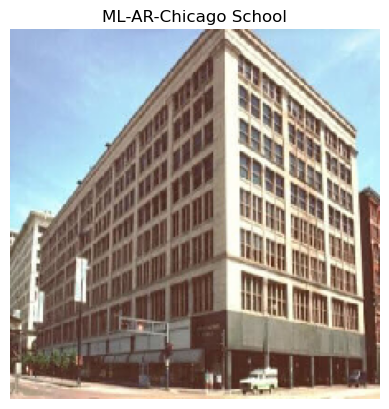

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Top 3 Predictions:
ML-AR-Chicago School : 99.78%
ML-AR-Modern Minimal : 0.22%
ML-AR-Modern : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


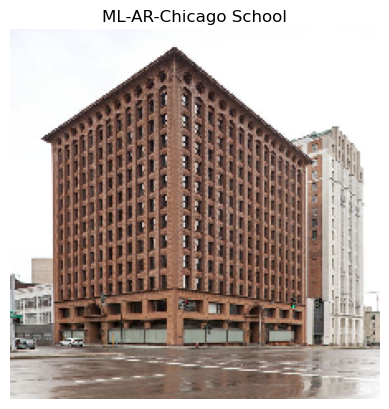

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
Top 3 Predictions:
ML-AR-Chicago School : 99.87%
ML-AR-Modern Minimal : 0.12%
ML-AR-VICTORIAN : 0.01%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


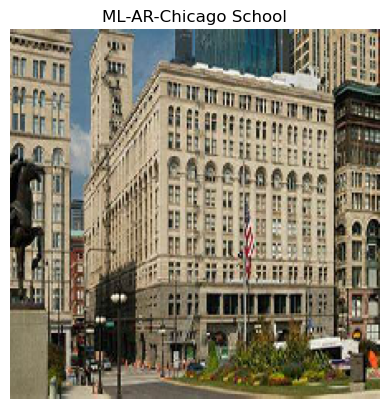

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Top 3 Predictions:
ML-AR-Chicago School : 99.99%
ML-AR-Modern Minimal : 0.01%
ML-AR-VICTORIAN : 0.00%
Actual Class: ML-AR-Chicago School
Prediction: ML-AR-Chicago School


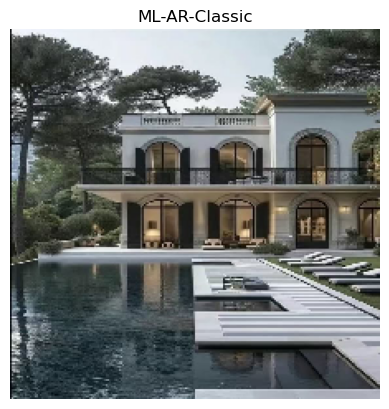

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Top 3 Predictions:
ML-AR-Classic : 32.52%
ML-AR-COLONIAL : 25.54%
ML-AR-VICTORIAN : 11.00%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Classic


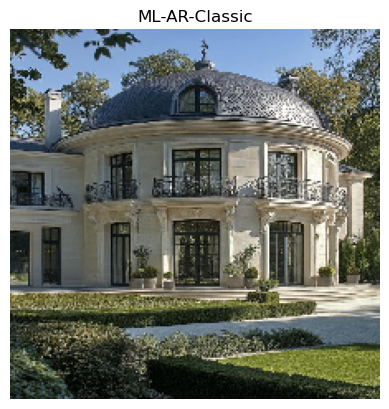

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Top 3 Predictions:
ML-AR-Classic : 17.02%
ML-AR-VICTORIAN : 16.60%
ML-AR-MEDITERRANEAN : 9.85%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Classic


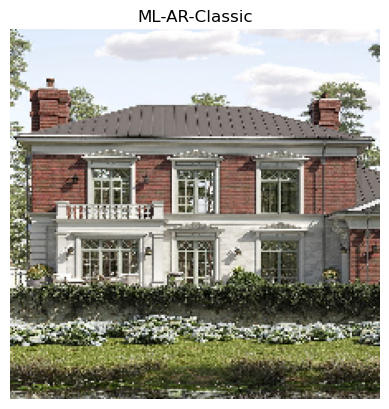

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 13.20%
ML-AR-Classic : 13.04%
ML-AR-COLONIAL : 12.45%
Actual Class: ML-AR-Classic
Prediction: ML-AR-VICTORIAN


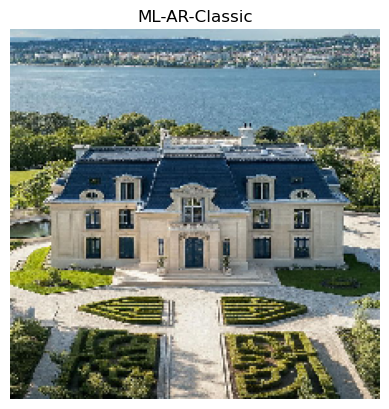

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 44.73%
ML-AR-Oriental : 10.08%
ML-AR-MID CENTURY : 9.23%
Actual Class: ML-AR-Classic
Prediction: ML-AR-MEDITERRANEAN


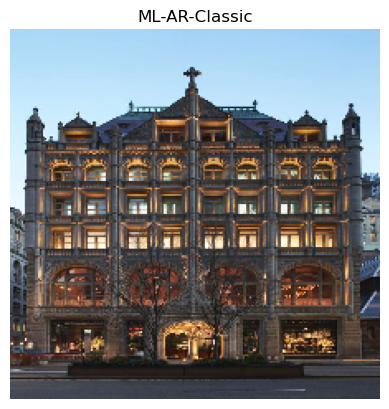

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
Top 3 Predictions:
ML-AR-Chicago School : 77.27%
ML-AR-VICTORIAN : 6.38%
ML-AR-Modern Minimal : 4.20%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Chicago School


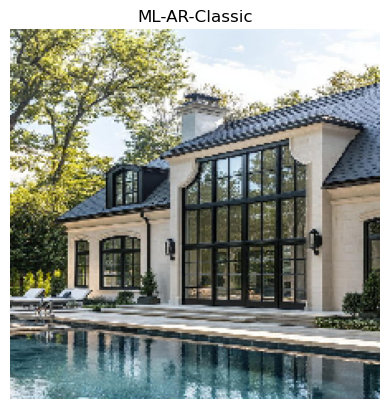

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 17.77%
ML-AR-Classic : 10.40%
ML-AR-VICTORIAN : 10.10%
Actual Class: ML-AR-Classic
Prediction: ML-AR-MEDITERRANEAN


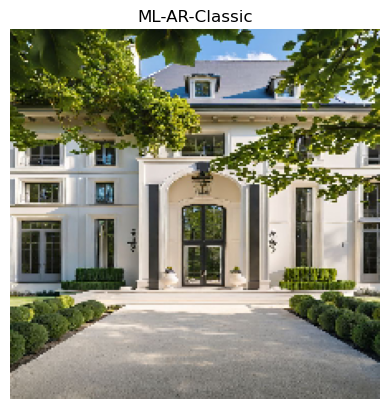

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Top 3 Predictions:
ML-AR-Classic : 26.88%
ML-AR-COLONIAL : 15.35%
ML-AR-VICTORIAN : 12.14%
Actual Class: ML-AR-Classic
Prediction: ML-AR-Classic


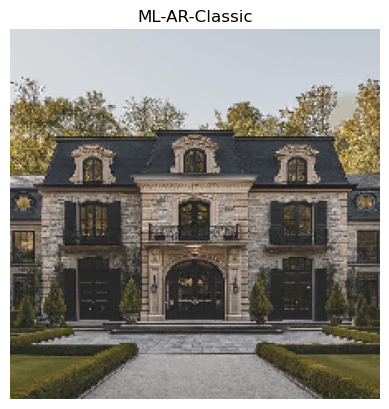

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 36.34%
ML-AR-TUDOR HOUSE : 16.42%
ML-AR-VICTORIAN : 10.78%
Actual Class: ML-AR-Classic
Prediction: ML-AR-TRANSITIONAL


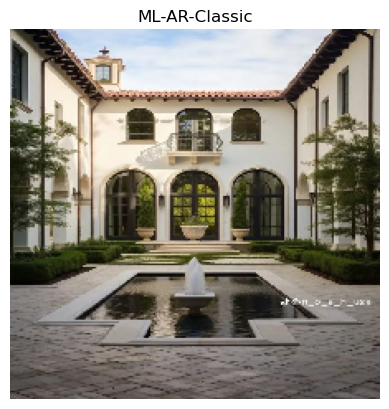

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 87.31%
ML-AR-Oriental : 2.96%
ML-AR-Classic : 2.50%
Actual Class: ML-AR-Classic
Prediction: ML-AR-MEDITERRANEAN


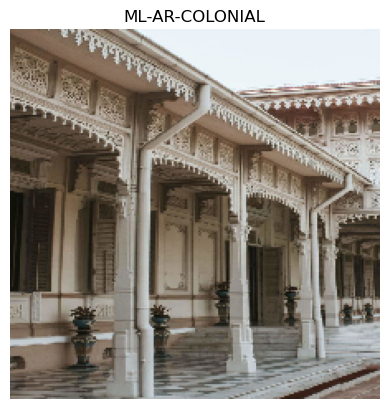

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 29.07%
ML-AR-VICTORIAN : 28.33%
ML-AR-Oriental : 22.50%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-COLONIAL


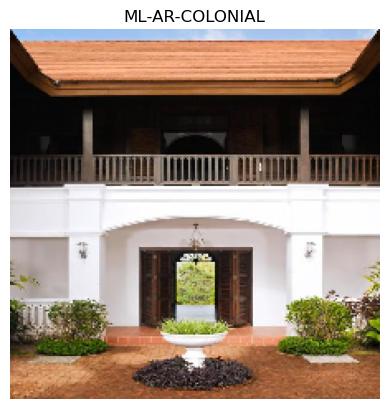

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
Top 3 Predictions:
ML-AR-Oriental : 33.62%
ML-AR-THAI : 21.31%
ML-AR-VICTORIAN : 8.54%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-Oriental


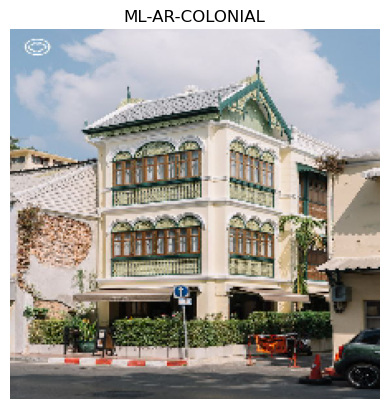

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 21.45%
ML-AR-COLONIAL : 19.14%
ML-AR-Oriental : 15.76%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-VICTORIAN


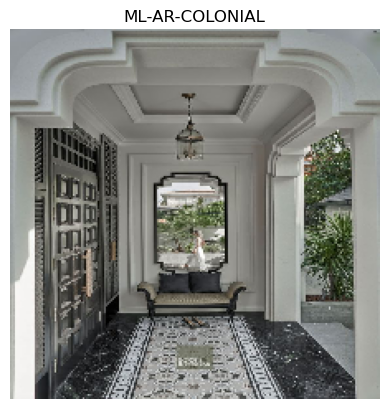

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
Top 3 Predictions:
ML-AR-Classic : 28.43%
ML-AR-VICTORIAN : 25.44%
ML-AR-COLONIAL : 19.64%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-Classic


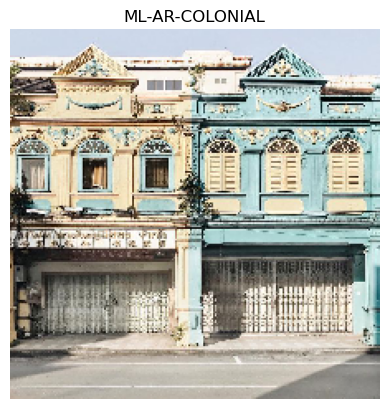

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 54.34%
ML-AR-COLONIAL : 17.25%
ML-AR-Oriental : 8.82%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-VICTORIAN


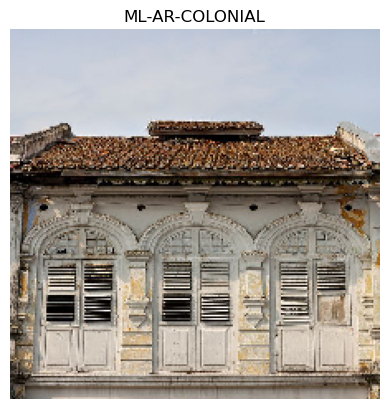

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 30.80%
ML-AR-VICTORIAN : 27.74%
ML-AR-Oriental : 17.11%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-COLONIAL


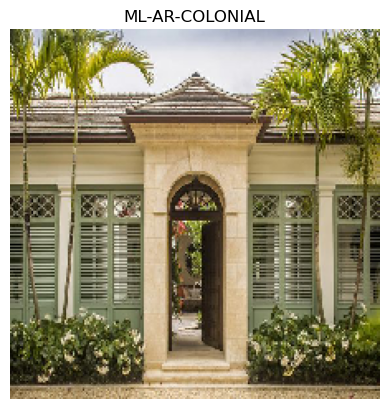

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Top 3 Predictions:
ML-AR-Classic : 39.63%
ML-AR-COLONIAL : 26.77%
ML-AR-VICTORIAN : 16.41%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-Classic


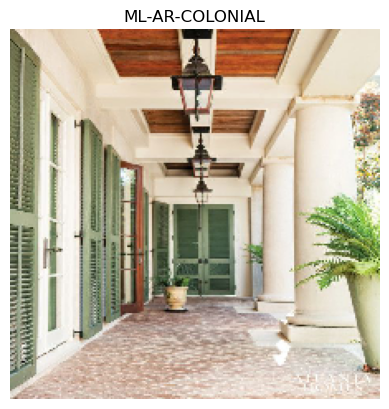

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 19.14%
ML-AR-Classic : 12.24%
ML-AR-VICTORIAN : 9.94%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-COLONIAL


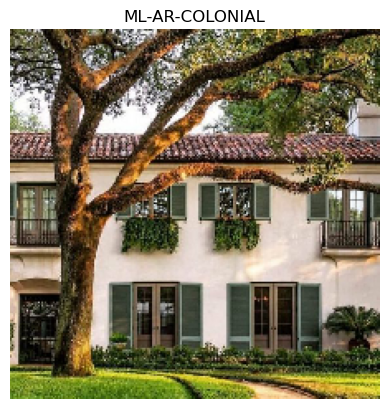

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 29.05%
ML-AR-MID CENTURY : 13.82%
ML-AR-SCANDINAVIAN : 10.07%
Actual Class: ML-AR-COLONIAL
Prediction: ML-AR-MEDITERRANEAN


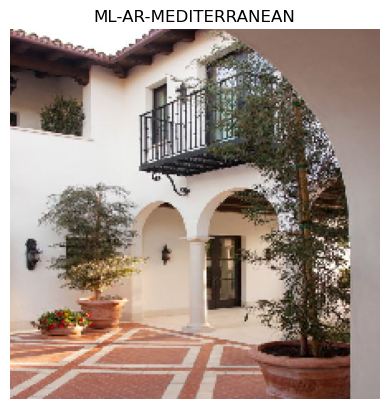

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 88.82%
ML-AR-SCANDINAVIAN : 3.56%
ML-AR-MID CENTURY : 3.14%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


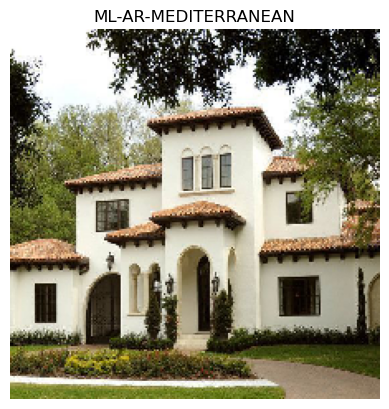

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 88.26%
ML-AR-SCANDINAVIAN : 3.35%
ML-AR-MID CENTURY : 2.60%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


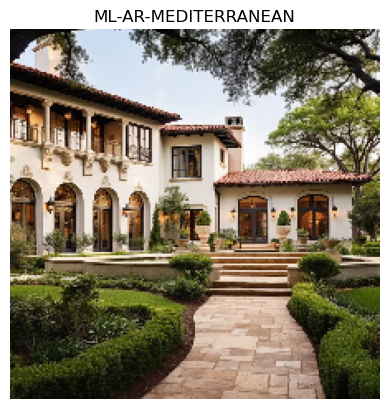

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 74.69%
ML-AR-MID CENTURY : 5.08%
ML-AR-Oriental : 4.86%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


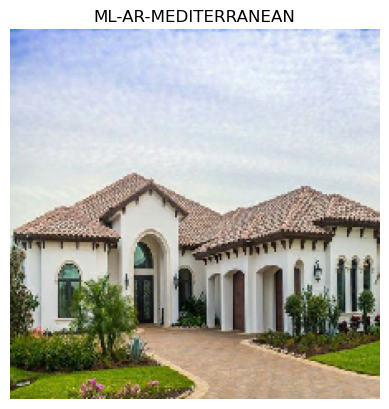

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 64.16%
ML-AR-Oriental : 8.99%
ML-AR-SCANDINAVIAN : 6.35%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


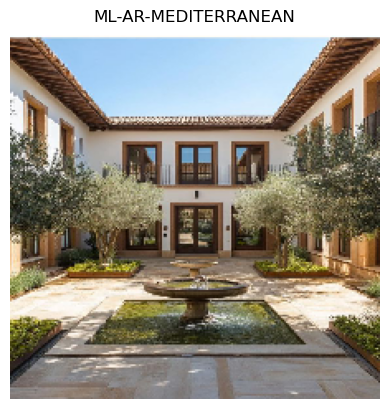

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 61.22%
ML-AR-TRANSITIONAL : 9.08%
ML-AR-SCANDINAVIAN : 8.89%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


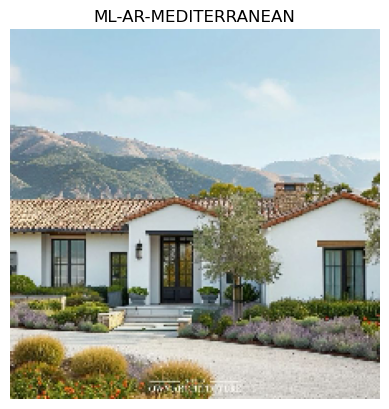

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 91.82%
ML-AR-SCANDINAVIAN : 2.85%
ML-AR-MID CENTURY : 2.10%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


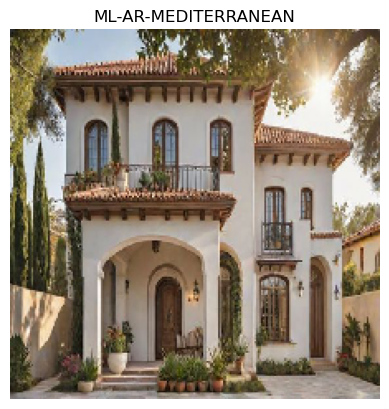

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 43.81%
ML-AR-Oriental : 22.15%
ML-AR-VICTORIAN : 14.18%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-COLONIAL


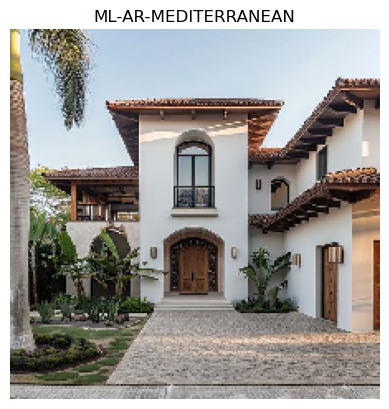

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 88.82%
ML-AR-SCANDINAVIAN : 3.36%
ML-AR-TRANSITIONAL : 2.07%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


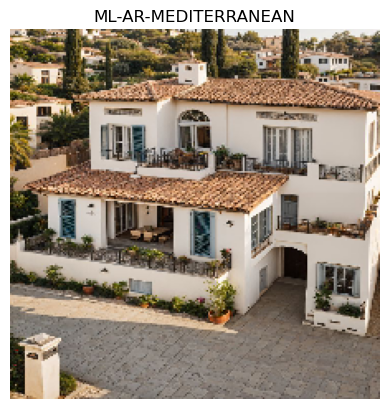

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 71.70%
ML-AR-Oriental : 5.73%
ML-AR-MID CENTURY : 5.61%
Actual Class: ML-AR-MEDITERRANEAN
Prediction: ML-AR-MEDITERRANEAN


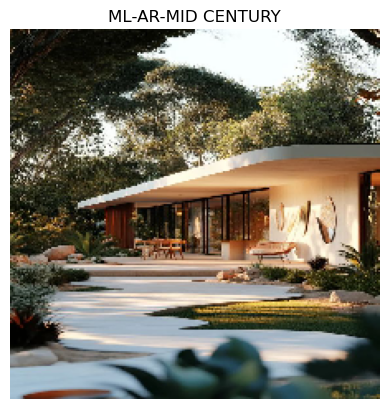

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 84.09%
ML-AR-MEDITERRANEAN : 6.14%
ML-AR-SCANDINAVIAN : 2.74%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


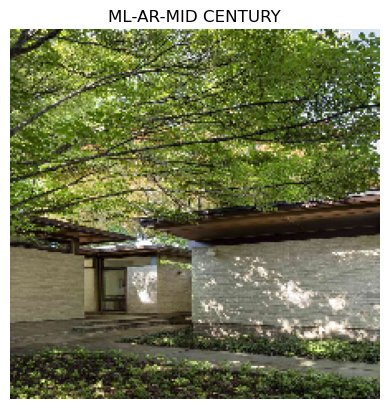

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.97%
ML-AR-Modern Minimal : 0.01%
ML-AR-SCANDINAVIAN : 0.01%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


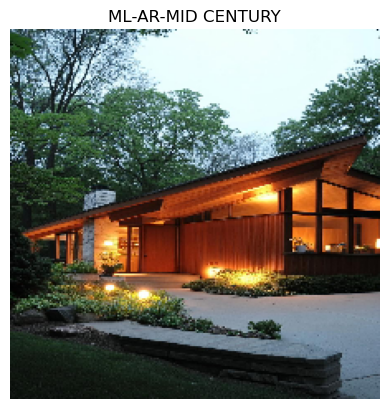

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 98.33%
ML-AR-MEDITERRANEAN : 0.62%
ML-AR-SCANDINAVIAN : 0.42%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


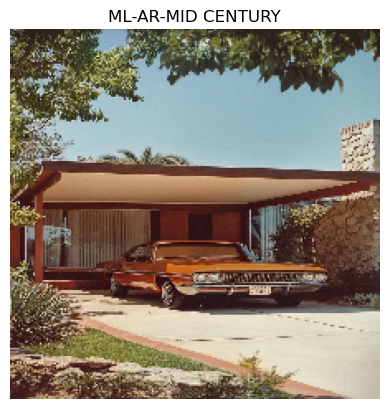

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 94.98%
ML-AR-MEDITERRANEAN : 2.06%
ML-AR-SCANDINAVIAN : 1.29%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


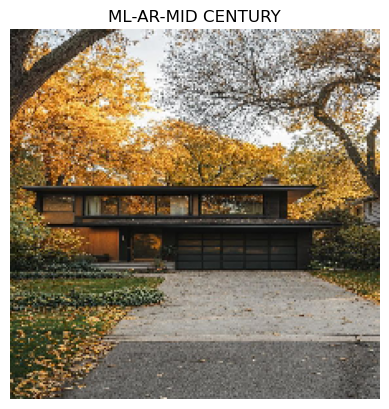

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 100.00%
ML-AR-Modern Minimal : 0.00%
ML-AR-SCANDINAVIAN : 0.00%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


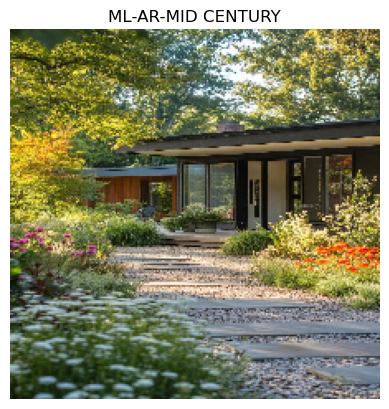

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.99%
ML-AR-SCANDINAVIAN : 0.00%
ML-AR-Modern Minimal : 0.00%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


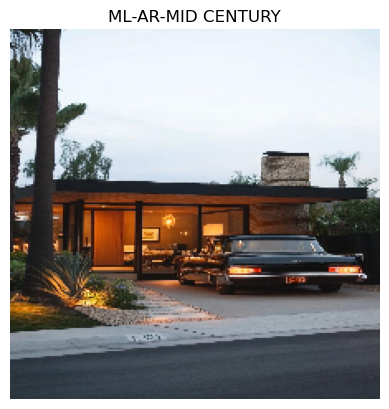

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 90.08%
ML-AR-Modern Minimal : 2.02%
ML-AR-SCANDINAVIAN : 1.73%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


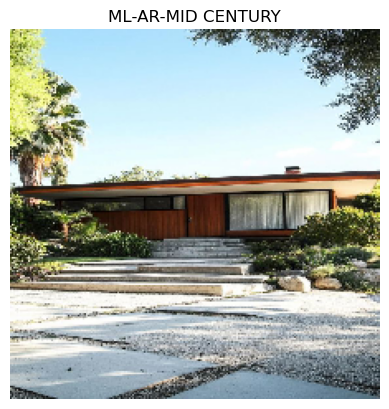

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.99%
ML-AR-Modern Minimal : 0.00%
ML-AR-SCANDINAVIAN : 0.00%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


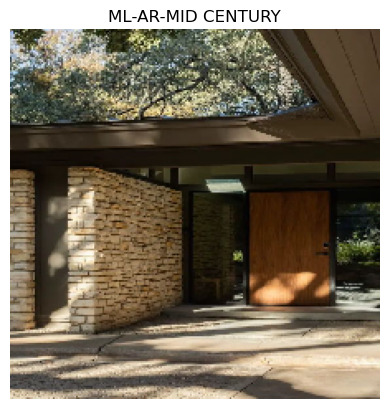

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 79.72%
ML-AR-COLONIAL : 3.64%
ML-AR-Modern Minimal : 3.57%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


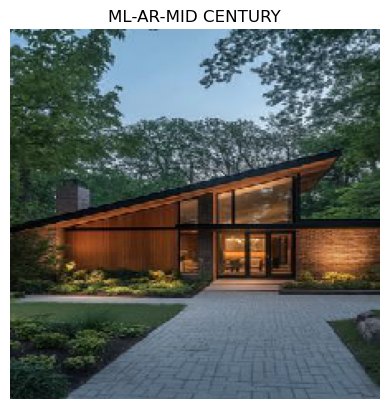

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.12%
ML-AR-SCANDINAVIAN : 0.22%
ML-AR-Modern Minimal : 0.21%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


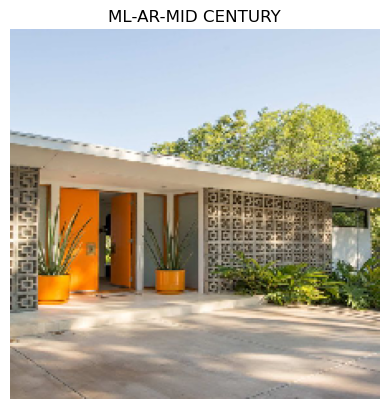

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 96.39%
ML-AR-SCANDINAVIAN : 0.92%
ML-AR-MEDITERRANEAN : 0.76%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


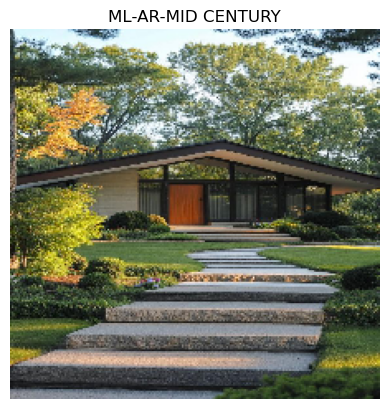

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 99.91%
ML-AR-SCANDINAVIAN : 0.02%
ML-AR-MEDITERRANEAN : 0.02%
Actual Class: ML-AR-MID CENTURY
Prediction: ML-AR-MID CENTURY


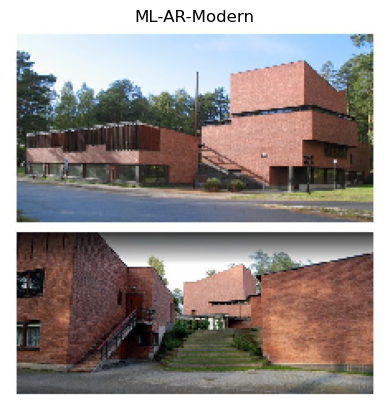

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 29.46%
ML-AR-Modern Minimal : 29.24%
ML-AR-SCANDINAVIAN : 11.26%
Actual Class: ML-AR-Modern
Prediction: ML-AR-MID CENTURY


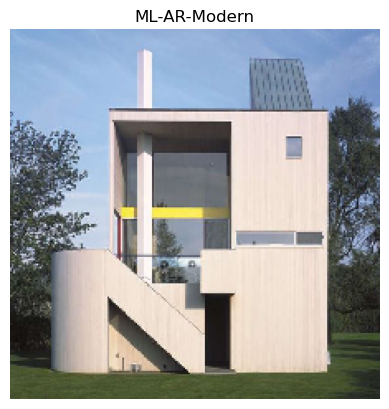

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 94.95%
ML-AR-Modern : 1.58%
ML-AR-SCANDINAVIAN : 1.57%
Actual Class: ML-AR-Modern
Prediction: ML-AR-Modern Minimal


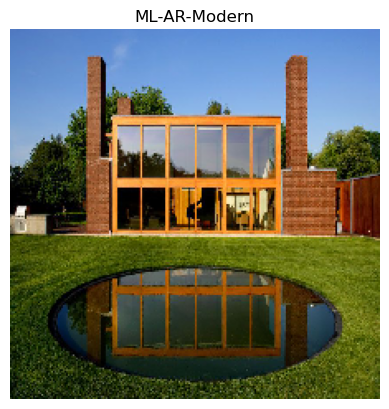

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 95.28%
ML-AR-Modern Minimal : 0.92%
ML-AR-SCANDINAVIAN : 0.82%
Actual Class: ML-AR-Modern
Prediction: ML-AR-MID CENTURY


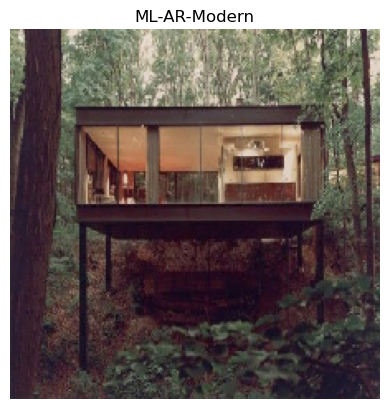

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
Top 3 Predictions:
ML-AR-THAI : 88.73%
ML-AR-Oriental : 4.99%
ML-AR-MID CENTURY : 2.53%
Actual Class: ML-AR-Modern
Prediction: ML-AR-THAI


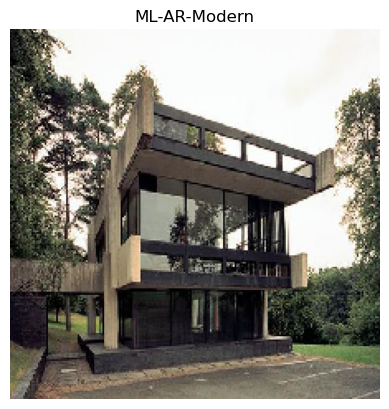

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
Top 3 Predictions:
ML-AR-THAI : 93.94%
ML-AR-TUDOR HOUSE : 2.35%
ML-AR-Oriental : 2.00%
Actual Class: ML-AR-Modern
Prediction: ML-AR-THAI


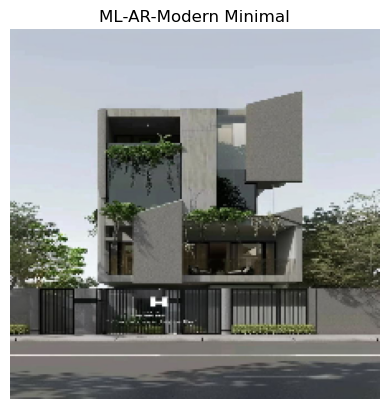

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 92.63%
ML-AR-Modern : 2.42%
ML-AR-COLONIAL : 1.14%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


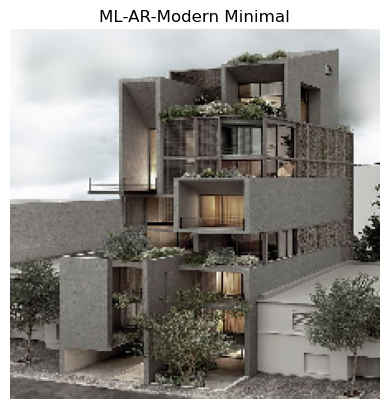

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 84.09%
ML-AR-Modern : 4.59%
ML-AR-COLONIAL : 2.40%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


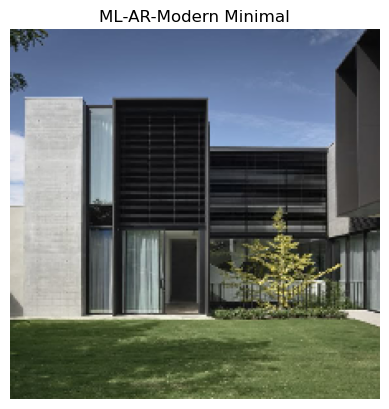

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 49.60%
ML-AR-Modern : 9.74%
ML-AR-COLONIAL : 7.55%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


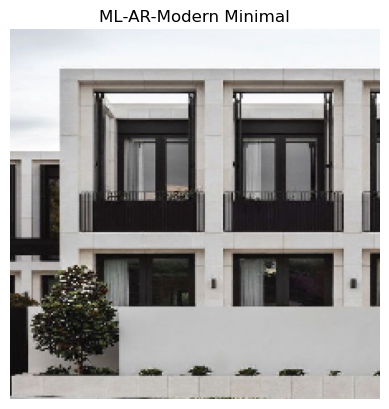

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 28.90%
ML-AR-Oriental : 14.42%
ML-AR-Classic : 9.90%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-COLONIAL


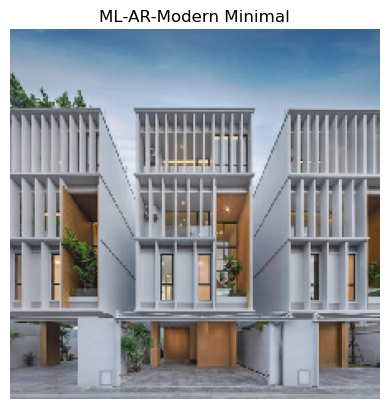

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 45.78%
ML-AR-COLONIAL : 15.17%
ML-AR-Modern : 9.23%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


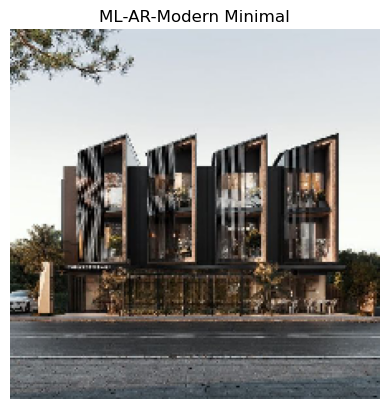

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 18.93%
ML-AR-COLONIAL : 10.18%
ML-AR-Modern : 10.05%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


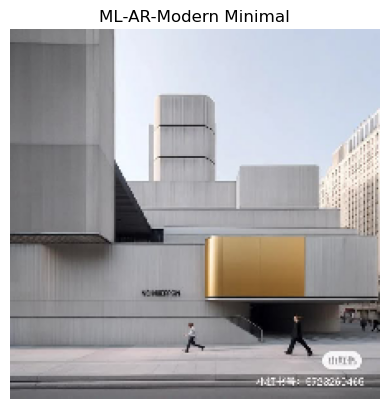

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 75.19%
ML-AR-SCANDINAVIAN : 6.18%
ML-AR-Modern : 5.55%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


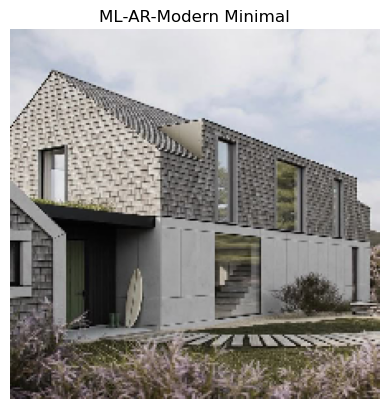

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 36.62%
ML-AR-SCANDINAVIAN : 20.53%
ML-AR-Modern : 9.44%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


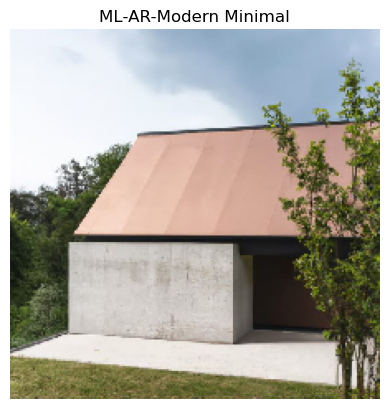

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 25.84%
ML-AR-SCANDINAVIAN : 21.05%
ML-AR-Modern : 9.30%
Actual Class: ML-AR-Modern Minimal
Prediction: ML-AR-Modern Minimal


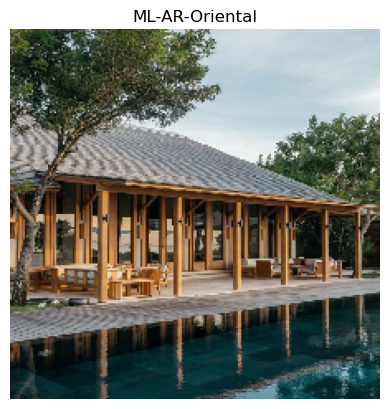

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 124ms/step
Top 3 Predictions:
ML-AR-Oriental : 47.69%
ML-AR-THAI : 16.83%
ML-AR-COLONIAL : 7.63%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-Oriental


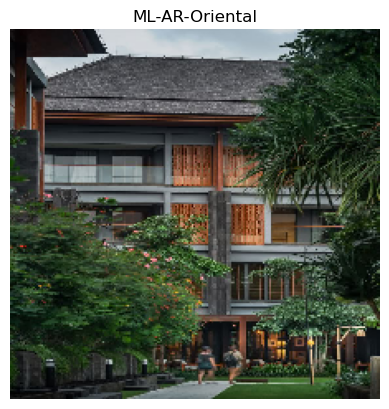

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
Top 3 Predictions:
ML-AR-THAI : 26.77%
ML-AR-Oriental : 18.28%
ML-AR-VICTORIAN : 7.79%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-THAI


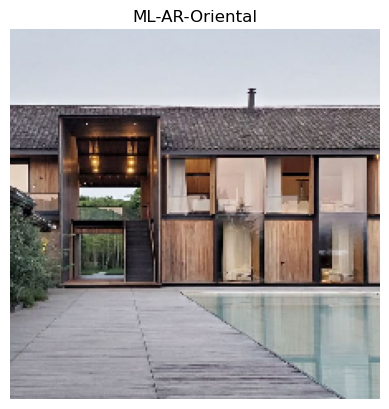

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 43.89%
ML-AR-MEDITERRANEAN : 17.89%
ML-AR-TRANSITIONAL : 6.91%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-SCANDINAVIAN


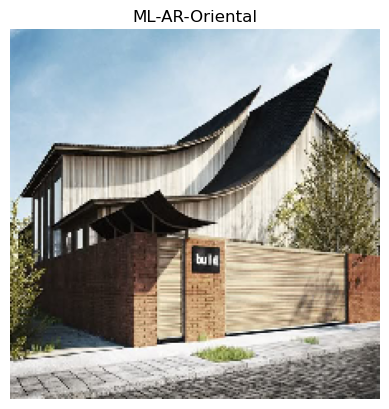

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 32.36%
ML-AR-Modern Minimal : 14.53%
ML-AR-TRANSITIONAL : 8.73%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-SCANDINAVIAN


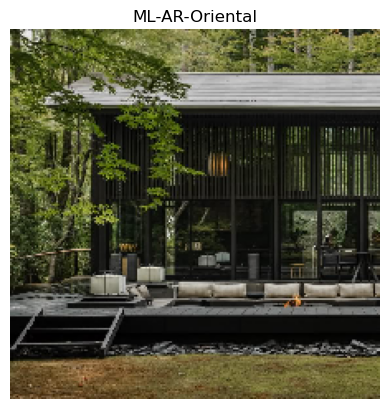

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step
Top 3 Predictions:
ML-AR-Oriental : 30.93%
ML-AR-THAI : 13.99%
ML-AR-VICTORIAN : 11.91%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-Oriental


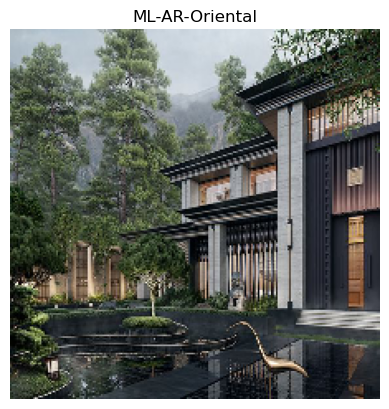

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step
Top 3 Predictions:
ML-AR-COLONIAL : 23.74%
ML-AR-Oriental : 13.80%
ML-AR-Classic : 10.91%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-COLONIAL


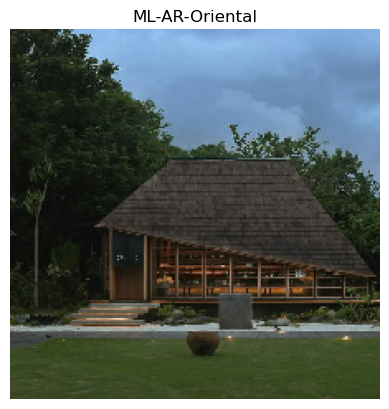

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 14.20%
ML-AR-THAI : 13.82%
ML-AR-Oriental : 12.90%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-TUDOR HOUSE


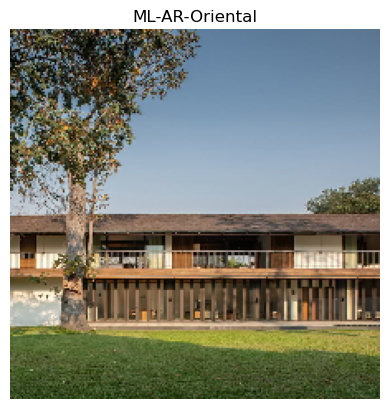

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
Top 3 Predictions:
ML-AR-MID CENTURY : 90.37%
ML-AR-MEDITERRANEAN : 1.99%
ML-AR-SCANDINAVIAN : 1.95%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-MID CENTURY


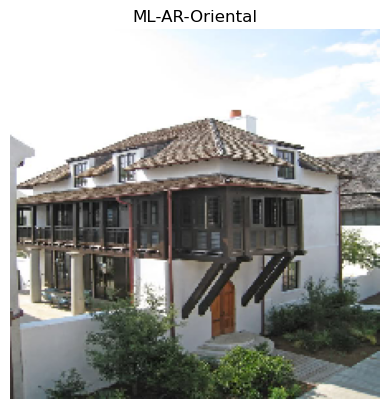

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
Top 3 Predictions:
ML-AR-Oriental : 20.60%
ML-AR-THAI : 18.91%
ML-AR-VICTORIAN : 9.12%
Actual Class: ML-AR-Oriental
Prediction: ML-AR-Oriental


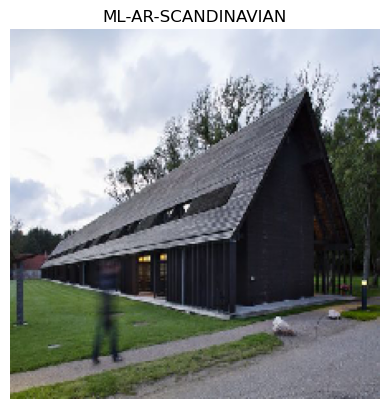

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 23.88%
ML-AR-Modern Minimal : 10.19%
ML-AR-TRANSITIONAL : 9.16%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


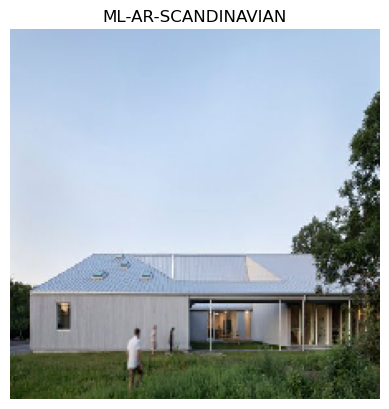

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 36.91%
ML-AR-Modern Minimal : 32.21%
ML-AR-Modern : 6.50%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


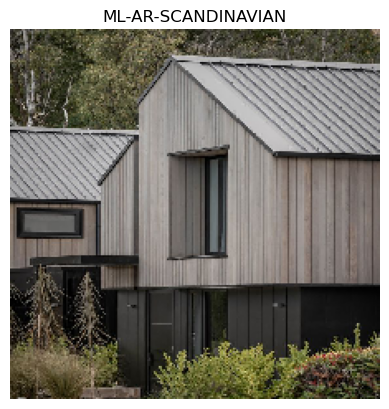

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 55.51%
ML-AR-Modern Minimal : 17.38%
ML-AR-TRANSITIONAL : 6.42%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


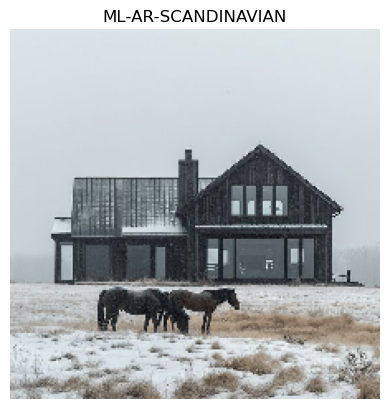

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 145ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 64.59%
ML-AR-Modern Minimal : 8.99%
ML-AR-MEDITERRANEAN : 6.69%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


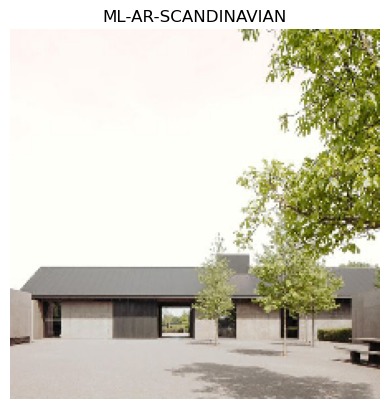

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 60.74%
ML-AR-SCANDINAVIAN : 14.59%
ML-AR-Modern : 7.25%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-Modern Minimal


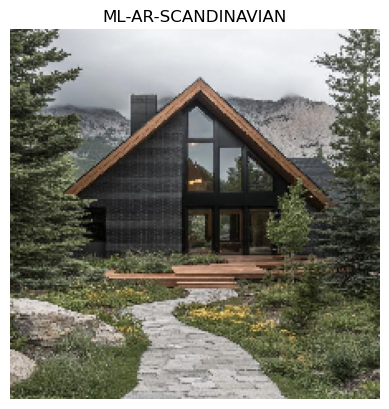

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 63.85%
ML-AR-TRANSITIONAL : 27.41%
ML-AR-THAI : 3.24%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-TUDOR HOUSE


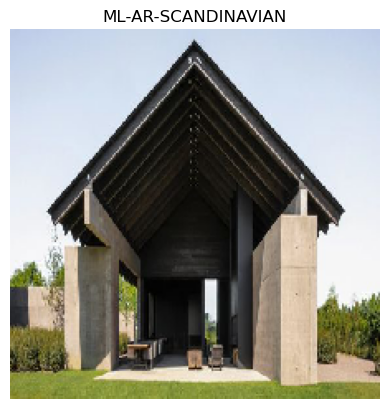

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step
Top 3 Predictions:
ML-AR-SCANDINAVIAN : 22.92%
ML-AR-Modern Minimal : 10.89%
ML-AR-THAI : 9.44%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-SCANDINAVIAN


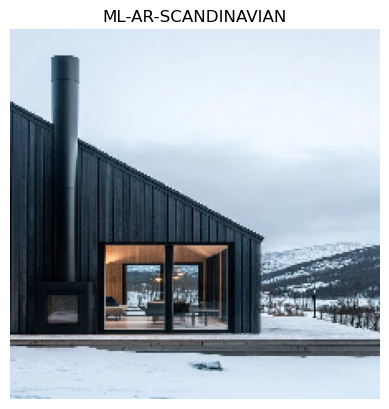

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
Top 3 Predictions:
ML-AR-Modern Minimal : 34.51%
ML-AR-SCANDINAVIAN : 28.27%
ML-AR-Modern : 8.10%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-Modern Minimal


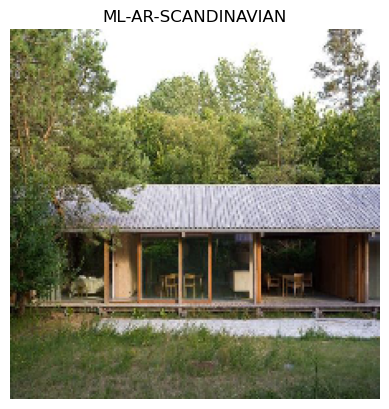

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
Top 3 Predictions:
ML-AR-Oriental : 32.42%
ML-AR-MEDITERRANEAN : 18.74%
ML-AR-SCANDINAVIAN : 11.94%
Actual Class: ML-AR-SCANDINAVIAN
Prediction: ML-AR-Oriental


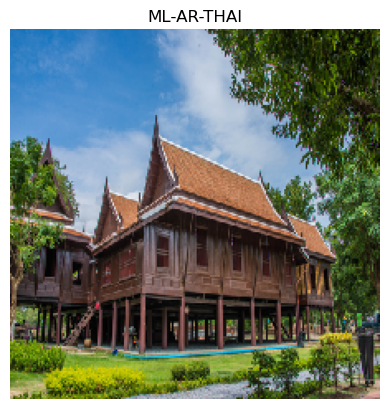

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
Top 3 Predictions:
ML-AR-THAI : 98.61%
ML-AR-TUDOR HOUSE : 0.71%
ML-AR-Oriental : 0.45%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


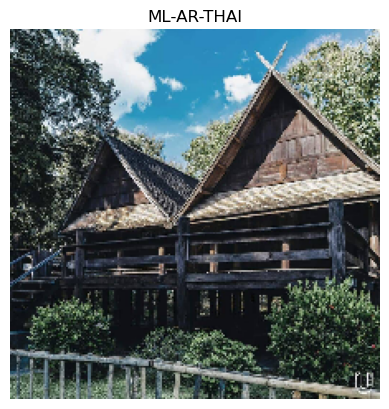

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
Top 3 Predictions:
ML-AR-THAI : 78.09%
ML-AR-TUDOR HOUSE : 14.26%
ML-AR-Oriental : 3.96%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


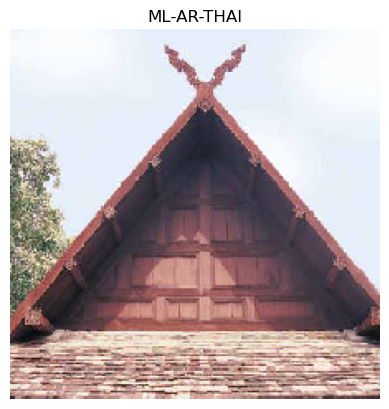

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
Top 3 Predictions:
ML-AR-THAI : 93.14%
ML-AR-TUDOR HOUSE : 5.57%
ML-AR-Oriental : 0.63%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


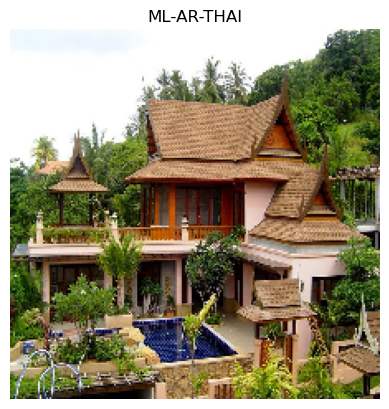

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 84ms/step
Top 3 Predictions:
ML-AR-THAI : 99.35%
ML-AR-TUDOR HOUSE : 0.47%
ML-AR-Oriental : 0.10%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


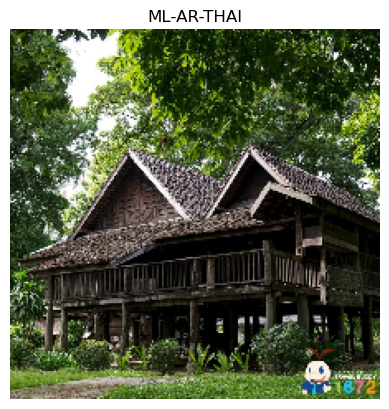

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step
Top 3 Predictions:
ML-AR-THAI : 82.40%
ML-AR-TUDOR HOUSE : 14.83%
ML-AR-Oriental : 1.46%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


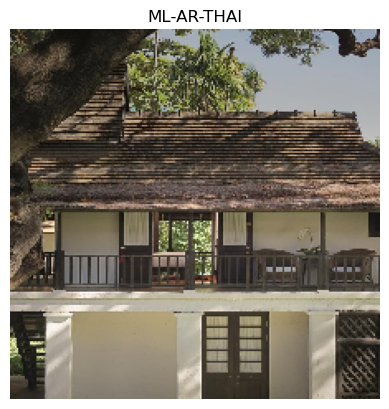

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
Top 3 Predictions:
ML-AR-THAI : 21.59%
ML-AR-Oriental : 20.92%
ML-AR-COLONIAL : 8.95%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


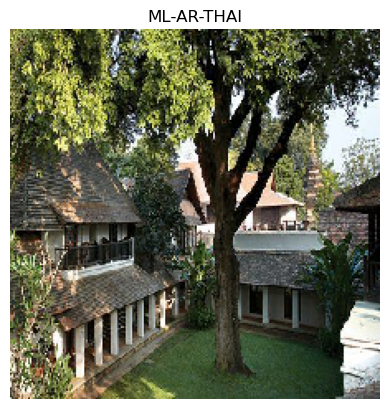

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
Top 3 Predictions:
ML-AR-THAI : 98.38%
ML-AR-Oriental : 0.66%
ML-AR-TUDOR HOUSE : 0.46%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


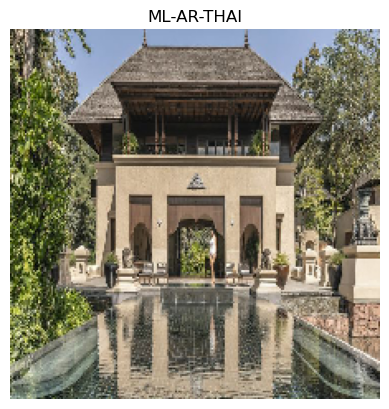

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
Top 3 Predictions:
ML-AR-Oriental : 59.82%
ML-AR-THAI : 11.12%
ML-AR-VICTORIAN : 8.65%
Actual Class: ML-AR-THAI
Prediction: ML-AR-Oriental


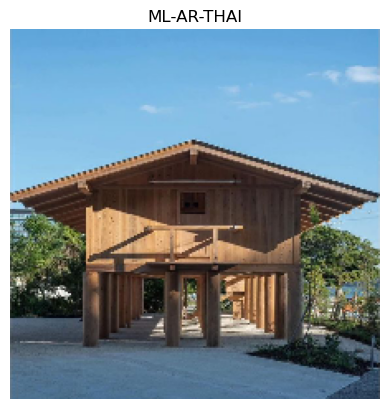

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
Top 3 Predictions:
ML-AR-MEDITERRANEAN : 28.90%
ML-AR-SCANDINAVIAN : 13.14%
ML-AR-Oriental : 10.12%
Actual Class: ML-AR-THAI
Prediction: ML-AR-MEDITERRANEAN


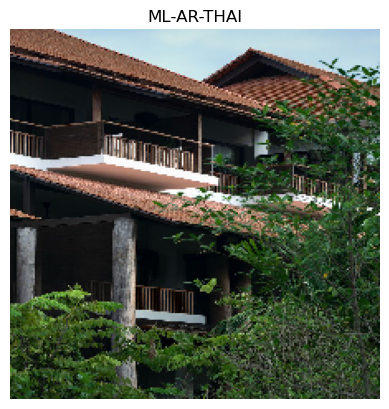

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
Top 3 Predictions:
ML-AR-THAI : 34.02%
ML-AR-Oriental : 21.92%
ML-AR-TUDOR HOUSE : 9.48%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


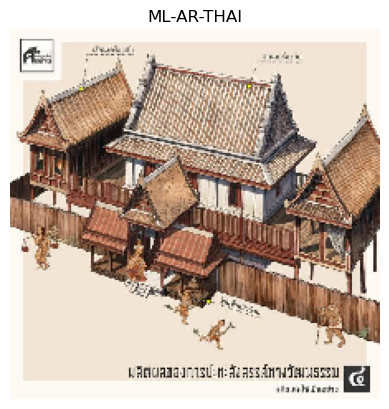

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
Top 3 Predictions:
ML-AR-THAI : 94.26%
ML-AR-TUDOR HOUSE : 5.33%
ML-AR-Oriental : 0.35%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


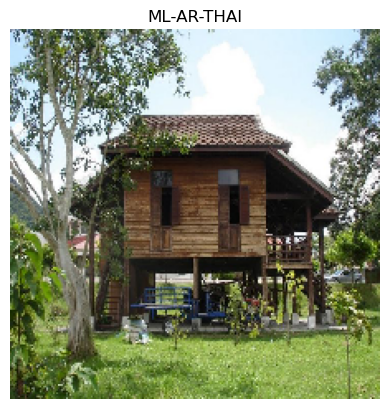

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
Top 3 Predictions:
ML-AR-THAI : 96.04%
ML-AR-TUDOR HOUSE : 1.62%
ML-AR-Oriental : 1.08%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


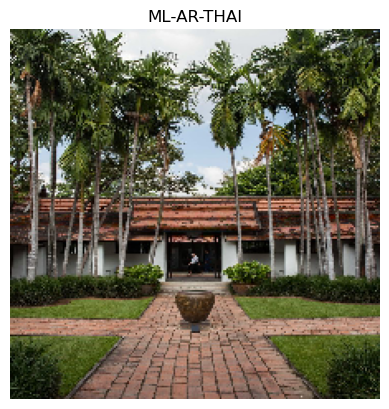

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step
Top 3 Predictions:
ML-AR-THAI : 99.53%
ML-AR-TUDOR HOUSE : 0.18%
ML-AR-MID CENTURY : 0.13%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


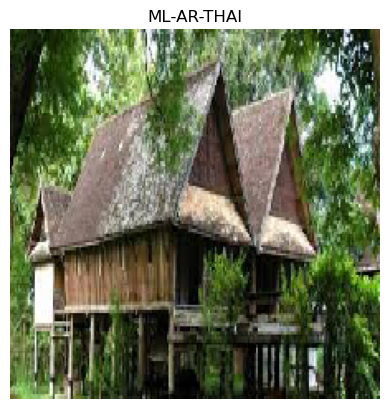

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
Top 3 Predictions:
ML-AR-THAI : 98.02%
ML-AR-TUDOR HOUSE : 1.48%
ML-AR-Oriental : 0.33%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


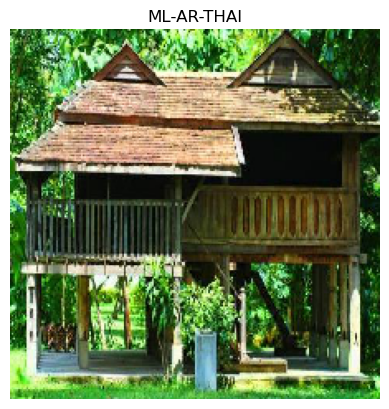

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
Top 3 Predictions:
ML-AR-THAI : 99.93%
ML-AR-Oriental : 0.04%
ML-AR-TUDOR HOUSE : 0.03%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


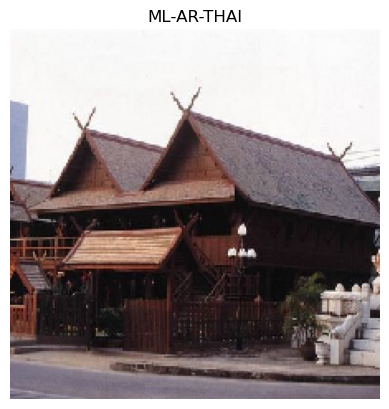

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step
Top 3 Predictions:
ML-AR-THAI : 95.86%
ML-AR-TUDOR HOUSE : 2.52%
ML-AR-Oriental : 1.09%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


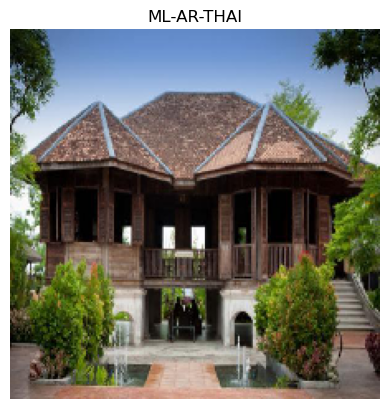

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
Top 3 Predictions:
ML-AR-THAI : 50.05%
ML-AR-TUDOR HOUSE : 28.23%
ML-AR-Oriental : 7.99%
Actual Class: ML-AR-THAI
Prediction: ML-AR-THAI


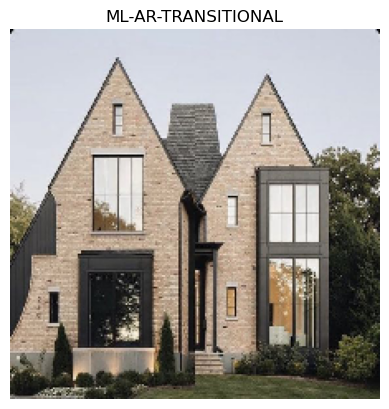

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 59.98%
ML-AR-TUDOR HOUSE : 37.43%
ML-AR-THAI : 0.94%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


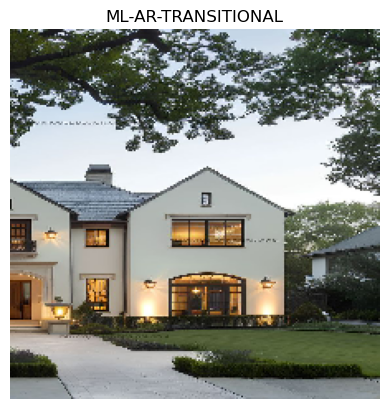

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 63.71%
ML-AR-TUDOR HOUSE : 22.78%
ML-AR-MEDITERRANEAN : 4.00%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


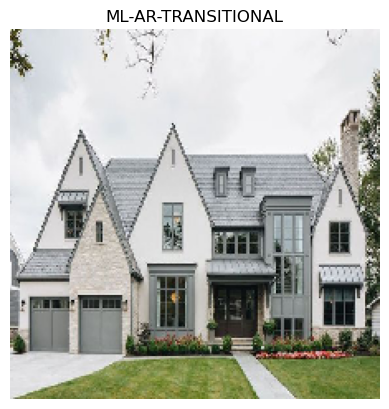

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 54.30%
ML-AR-TUDOR HOUSE : 30.13%
ML-AR-THAI : 3.01%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


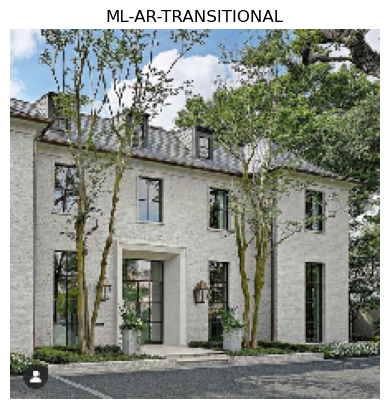

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 23.85%
ML-AR-VICTORIAN : 17.68%
ML-AR-Classic : 9.36%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


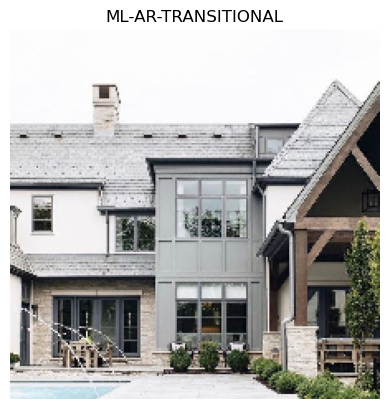

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 16.31%
ML-AR-COLONIAL : 13.75%
ML-AR-Oriental : 10.29%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-VICTORIAN


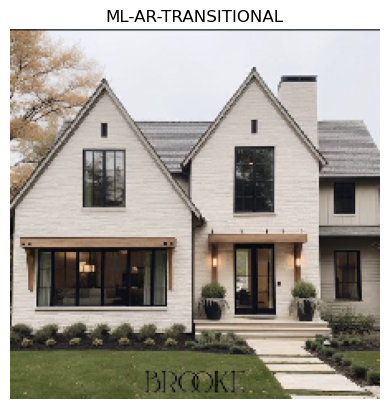

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 66.58%
ML-AR-TUDOR HOUSE : 26.70%
ML-AR-THAI : 1.55%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


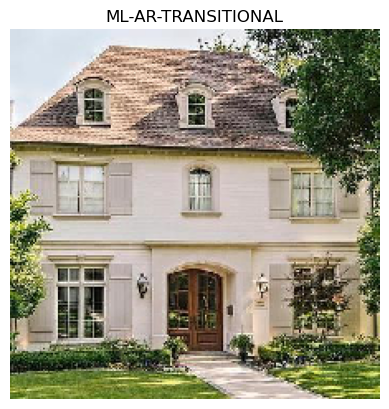

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 39.92%
ML-AR-TUDOR HOUSE : 13.36%
ML-AR-MEDITERRANEAN : 10.59%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


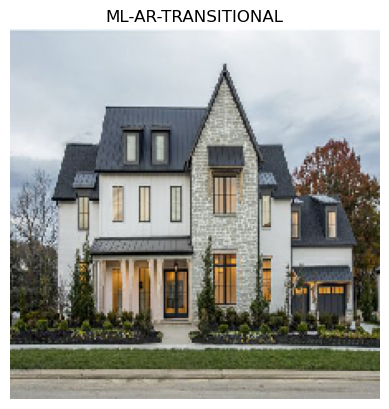

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 50.00%
ML-AR-TUDOR HOUSE : 26.56%
ML-AR-THAI : 4.30%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TRANSITIONAL


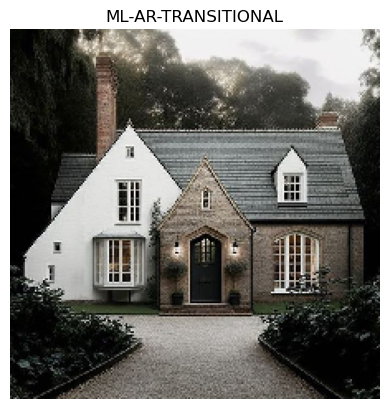

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 136ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 47.73%
ML-AR-TRANSITIONAL : 47.36%
ML-AR-THAI : 1.79%
Actual Class: ML-AR-TRANSITIONAL
Prediction: ML-AR-TUDOR HOUSE


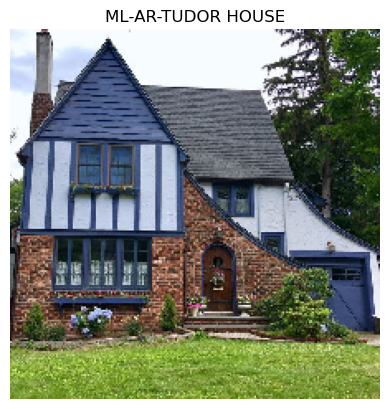

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 85.31%
ML-AR-TRANSITIONAL : 10.02%
ML-AR-THAI : 3.16%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


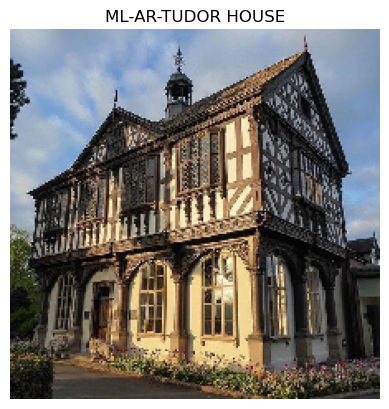

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 77.41%
ML-AR-TRANSITIONAL : 10.38%
ML-AR-VICTORIAN : 3.36%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


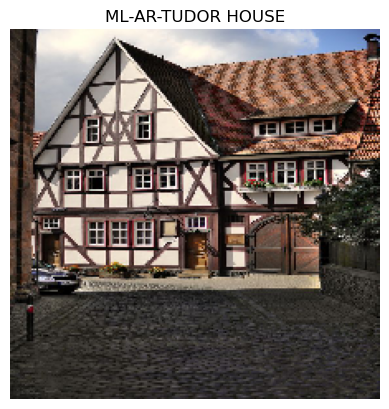

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 84.41%
ML-AR-TRANSITIONAL : 11.25%
ML-AR-THAI : 2.60%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


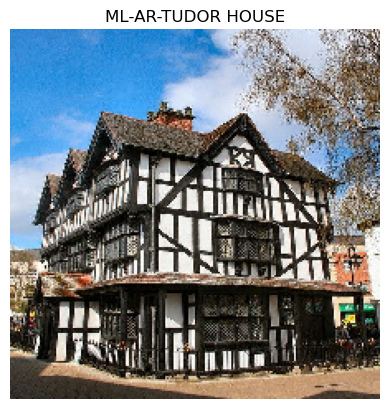

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 137ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 99.49%
ML-AR-TRANSITIONAL : 0.29%
ML-AR-THAI : 0.19%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


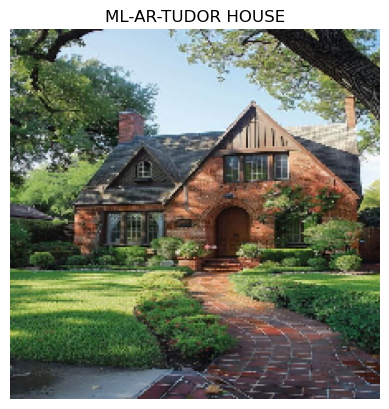

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 97.50%
ML-AR-TRANSITIONAL : 1.83%
ML-AR-THAI : 0.57%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


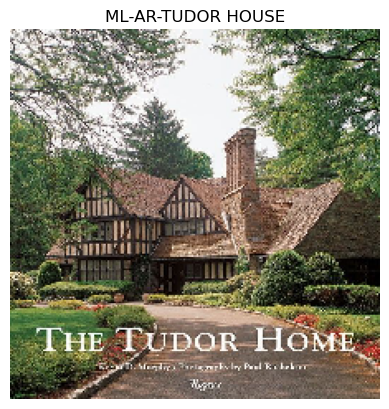

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 91.80%
ML-AR-TRANSITIONAL : 3.59%
ML-AR-THAI : 3.43%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


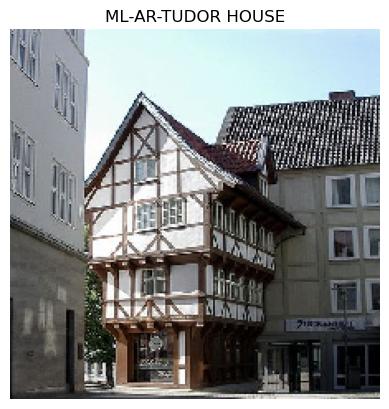

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 72.48%
ML-AR-TRANSITIONAL : 9.62%
ML-AR-THAI : 4.55%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


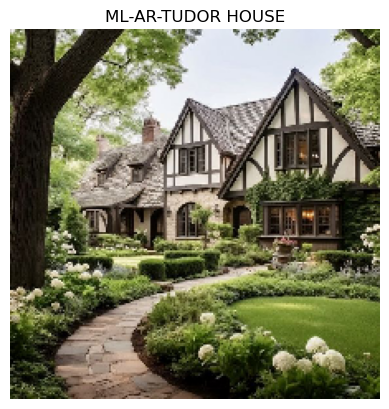

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 170ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 86.21%
ML-AR-TRANSITIONAL : 10.08%
ML-AR-THAI : 2.04%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


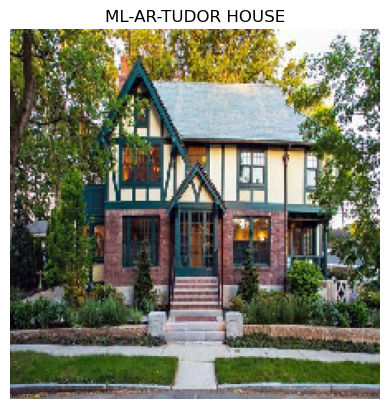

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 139ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 48.69%
ML-AR-THAI : 40.62%
ML-AR-TRANSITIONAL : 5.26%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


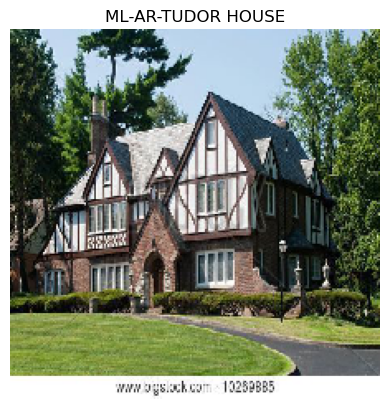

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 147ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 97.75%
ML-AR-TRANSITIONAL : 1.64%
ML-AR-THAI : 0.52%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


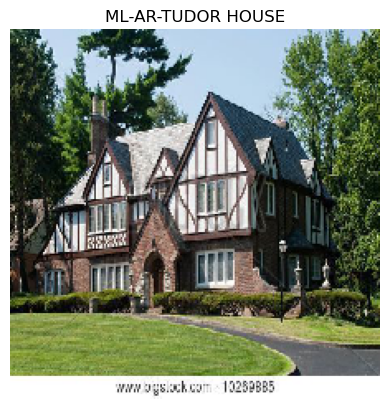

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 97.75%
ML-AR-TRANSITIONAL : 1.64%
ML-AR-THAI : 0.52%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


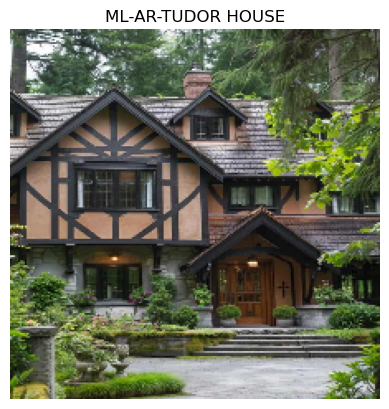

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 89.71%
ML-AR-TRANSITIONAL : 6.33%
ML-AR-THAI : 2.98%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


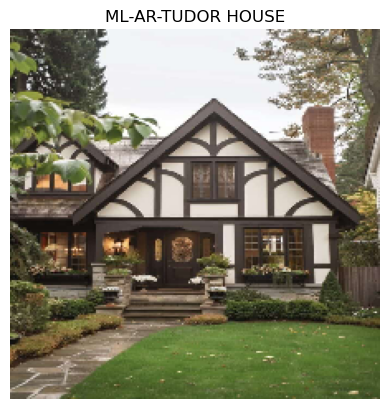

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 144ms/step
Top 3 Predictions:
ML-AR-TUDOR HOUSE : 88.73%
ML-AR-TRANSITIONAL : 8.03%
ML-AR-THAI : 2.09%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TUDOR HOUSE


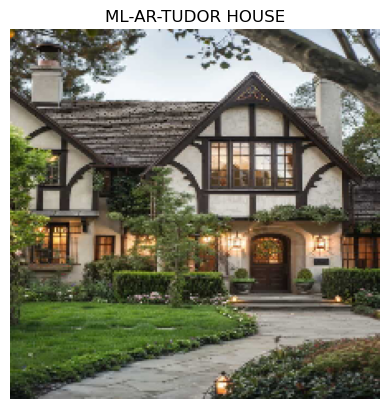

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 53.14%
ML-AR-TUDOR HOUSE : 32.82%
ML-AR-MEDITERRANEAN : 4.30%
Actual Class: ML-AR-TUDOR HOUSE
Prediction: ML-AR-TRANSITIONAL


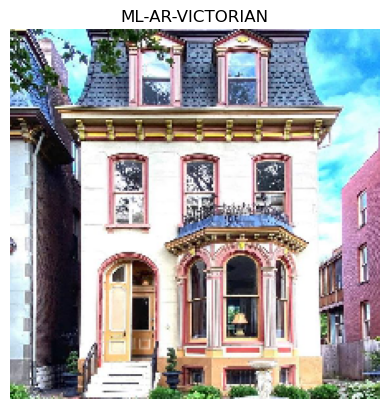

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 39.65%
ML-AR-COLONIAL : 31.72%
ML-AR-Oriental : 14.10%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


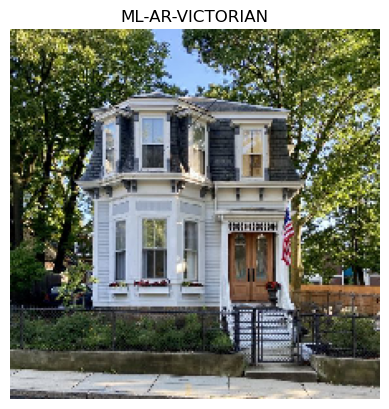

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 36.02%
ML-AR-COLONIAL : 19.02%
ML-AR-Classic : 16.41%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


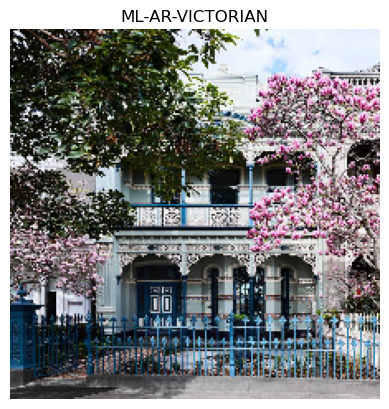

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 138ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 48.59%
ML-AR-COLONIAL : 14.26%
ML-AR-Oriental : 11.09%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


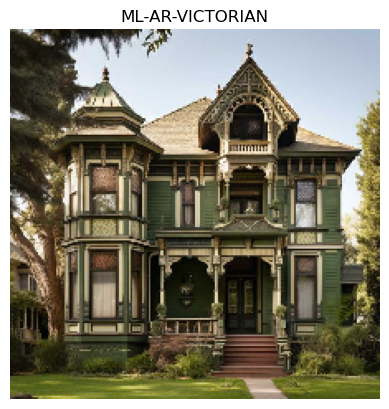

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 23.70%
ML-AR-VICTORIAN : 20.17%
ML-AR-TUDOR HOUSE : 13.17%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-TRANSITIONAL


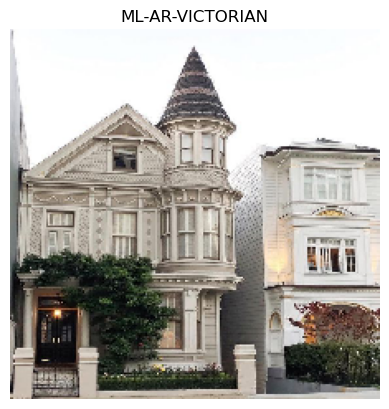

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 123ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 39.13%
ML-AR-TRANSITIONAL : 10.58%
ML-AR-Classic : 7.11%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


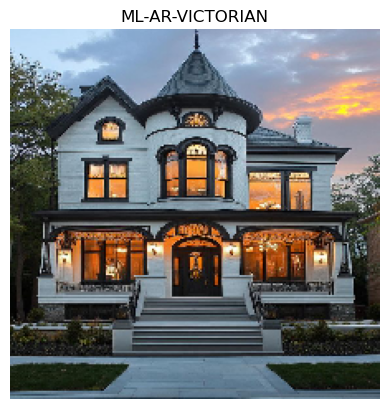

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 127ms/step
Top 3 Predictions:
ML-AR-TRANSITIONAL : 38.82%
ML-AR-TUDOR HOUSE : 17.91%
ML-AR-MEDITERRANEAN : 8.32%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-TRANSITIONAL


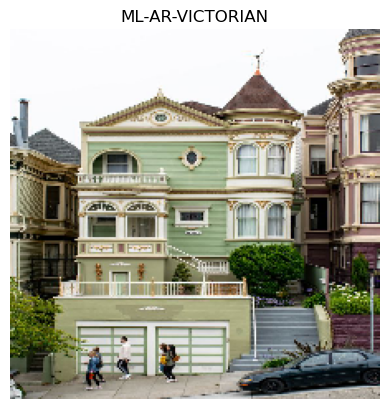

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 33.45%
ML-AR-Classic : 19.93%
ML-AR-COLONIAL : 19.25%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


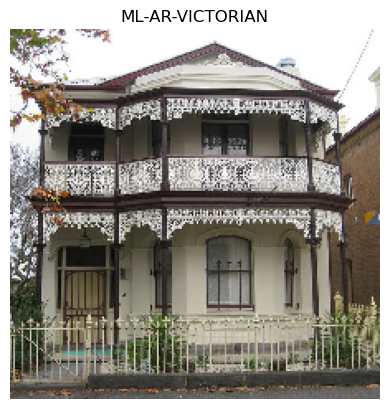

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 28.66%
ML-AR-Oriental : 21.33%
ML-AR-COLONIAL : 21.00%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


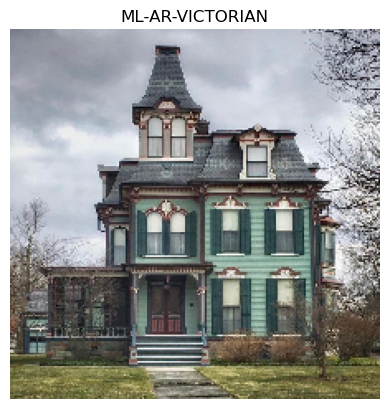

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
Top 3 Predictions:
ML-AR-VICTORIAN : 56.33%
ML-AR-Classic : 5.84%
ML-AR-Oriental : 5.51%
Actual Class: ML-AR-VICTORIAN
Prediction: ML-AR-VICTORIAN


In [23]:
import glob

import glob

# Get all images in the subfolders of "test"
# mylist = [f for f in glob.glob(r'D:\Real Estate\House_Style_Project\House_style_ML\Train_Test_Folder\test\**\*', recursive=True) if not os.path.isdir(f)]
mylist = [
    f for f in glob.glob(os.path.join(os.path.join(os.getcwd(), 'Train_Test_Folder', 'test'), '**', '*'), recursive=True)
    if not os.path.isdir(f)
]
# # Print the list of image paths
# print(mylist)

for i in mylist:
    predict(i)
    # print(os.path.basename(i), end = '/')